In [ ]:
!git clone https://github.com/cocodataset/cocoapi.git
%cd cocoapi/PythonAPI
!python setup.py build_ext install
%cd ../../

Cloning into 'cocoapi'...
remote: Enumerating objects: 975, done.
remote: Total 975 (delta 0), reused 0 (delta 0), pack-reused 975 (from 1)
Receiving objects: 100% (975/975), 11.72 MiB | 16.72 MiB/s, done.
Resolving deltas: 100% (576/576), done.
/content/cocoapi/PythonAPI
running build_ext
Compiling pycocotools/_mask.pyx because it changed.
[1/1] Cythonizing pycocotools/_mask.pyx
/usr/local/lib/python3.10/dist-packages/Cython/Compiler/Main.py:381: FutureWarning: Cython directive 'language_level' not set, using '3str' for now (Py3). This has changed from earlier releases! File: /content/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build/temp.linux-x86_64-cpython-310/../common
creating build/temp.linux-x86_64-cpython-310/pycocotools
x86_64-linux-gnu-gcc -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -g -fwrapv -O2 -fP

In [ ]:
import requests
import zipfile
import io
import os

# URL for the COCO annotations ZIP file
zip_url = "http://images.cocodataset.org/annotations/annotations_trainval2017.zip"

# Download and extract the ZIP file
response = requests.get(zip_url)
if response.status_code == 200:
    print("Downloading annotations...")
    with zipfile.ZipFile(io.BytesIO(response.content)) as z:
        # Extract the specific file we need
        z.extract("annotations/instances_train2017.json", path="./")
        print("Extraction complete!")
else:
    raise Exception(f"Failed to fetch annotations ZIP: {response.status_code}")


Extraction complete!


In [ ]:
from pycocotools.coco import COCO

# Path to the extracted JSON file
annotation_file = "annotations/instances_train2017.json"

# Initialize COCO API
coco = COCO(annotation_file)

# List all categories
categories = coco.loadCats(coco.getCatIds())
print("Categories:", [cat['name'] for cat in categories])

loading annotations into memory...
Done (t=25.69s)
creating index...
index created!
Categories: ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


In [ ]:
# Define household-related categories
household_categories = [
    "chair", "couch", "bed", "dining table", "microwave", "oven",
    "toaster", "sink", "refrigerator", "tv", "potted plant", "vase",
]
# Initialize a set to collect unique image IDs
combined_image_ids = set()

# Loop through each category and collect image IDs
for category in household_categories:
    category_ids = coco.getCatIds(catNms=[category])  # Get category ID
    image_ids = set(coco.getImgIds(catIds=category_ids))  # Get image IDs for this category
    combined_image_ids |= image_ids  # Union with the existing set of IDs

# Final count of unique images containing any household item
print(f"Number of images containing any household items: {len(combined_image_ids)}")

Number of images containing any household items: 34668


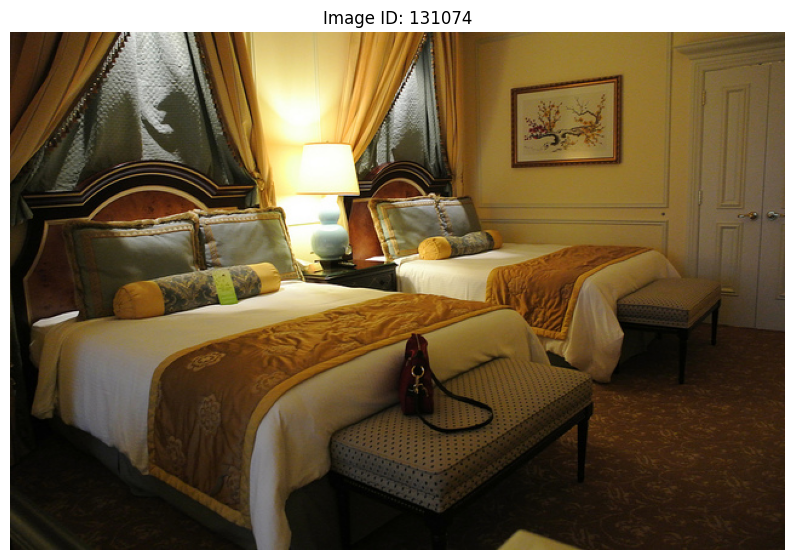

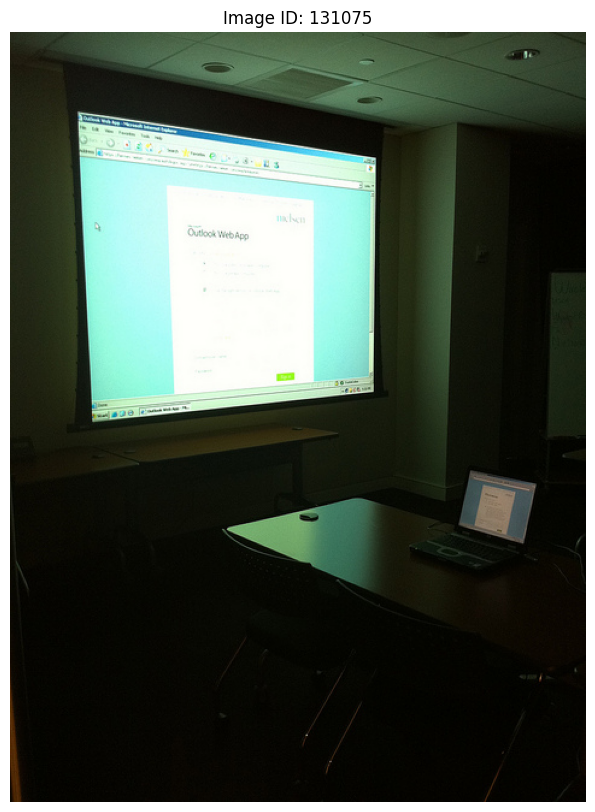

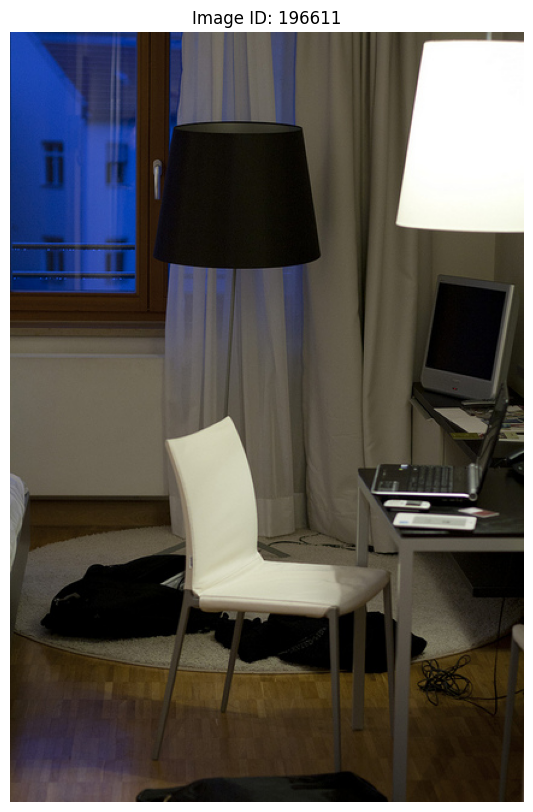

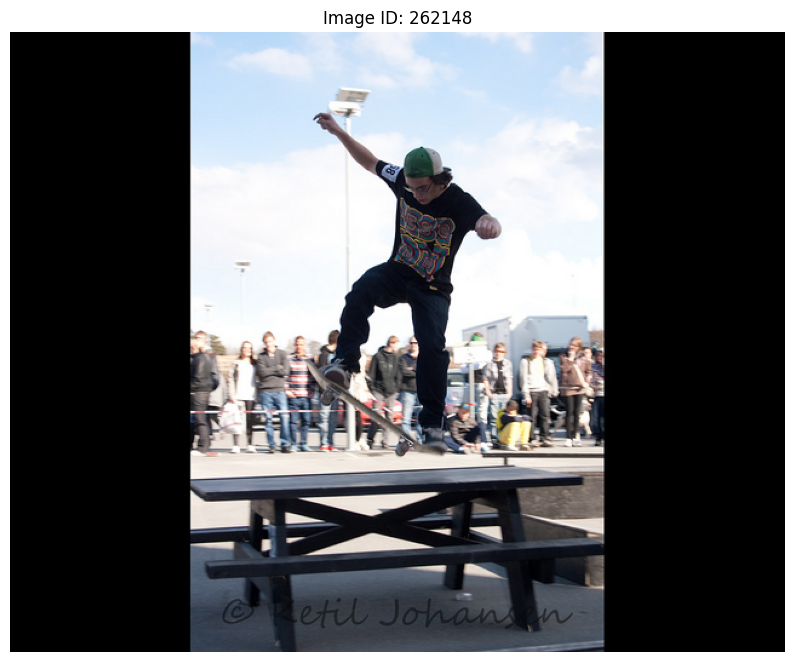

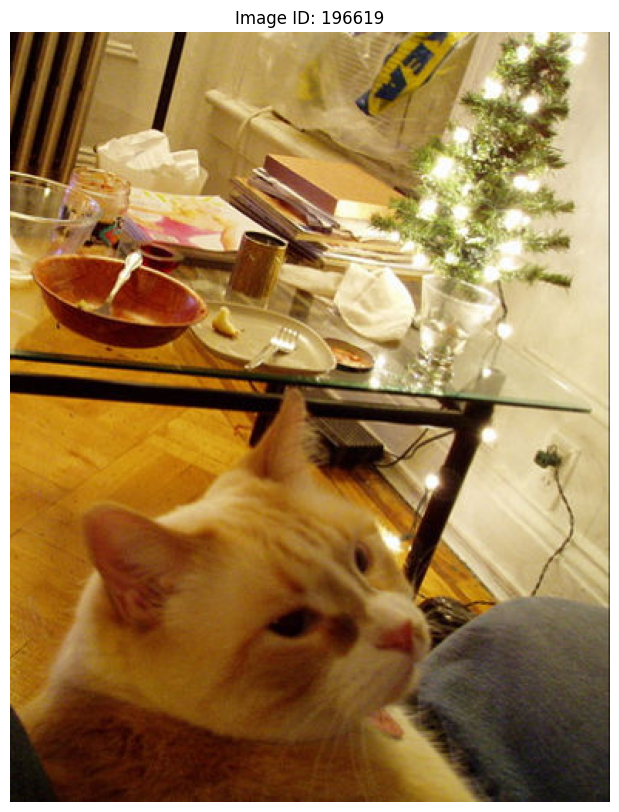

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import requests

# Convert the set of image IDs to a list
image_ids_list = list(combined_image_ids)

# Display the first few images
for i, image_id in enumerate(image_ids_list[:5]):  # Show the first 5 images
    # Load image metadata
    image_metadata = coco.loadImgs(image_id)[0]
    image_url = image_metadata['coco_url']

    # Fetch and display the image
    response = requests.get(image_url, stream=True)
    image = Image.open(response.raw)
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.title(f"Image ID: {image_id}")
    plt.show()

In [ ]:
!git clone https://github.com/IDEA-Research/DINO.git
%cd DINO

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (197/197), done.
remote: Compressing objects: 100% (104/104), done.
remote: Total 442 (delta 137), reused 93 (delta 93), pack-reused 245 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 13.78 MiB/s, done.
Resolving deltas: 100% (191/191), done.
/content/DINO/DINO


In [ ]:
!pip install torch torchvision timm opencv-python matplotlib scipy

In [ ]:
!ls

config	   figs				      main.py	 requirements.txt      tools
datasets   inference_and_visualization.ipynb  models	 run_with_submitit.py  util
engine.py  LICENSE			      README.md  scripts


In [ ]:
!wget https://dl.fbaipublicfiles.com/dino/dino_deformable_detr/models/dino_swinl.pth -P ./weights

--2024-12-05 16:03:03--  https://dl.fbaipublicfiles.com/dino/dino_deformable_detr/models/dino_swinl.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.226.210.111, 13.226.210.78, 13.226.210.15, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.226.210.111|:443... connected.
HTTP request sent, awaiting response... 403 Forbidden
2024-12-05 16:03:03 ERROR 403: Forbidden.



using detr instead of dino

In [ ]:
from transformers import DetrImageProcessor, DetrForObjectDetection

# Load DETR model and processor
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Preprocess the image
inputs = processor(images=image, return_tensors="pt")

# Perform object detection
outputs = model(**inputs)

# Post-process the results
target_sizes = [image.size]  # (width, height)
results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)

# Display predictions
for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
    label_name = model.config.id2label[label.item()]
    print(f"Detected {label_name} with confidence {score.item()} at box {box.tolist()}")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Detected dining table with confidence 0.9032135009765625 at box [0.9997785091400146, 77.43090057373047, 496.8484191894531, 200.4335174560547]
Detected cat with confidence 0.9033619165420532 at box [331.6769714355469, 282.1529846191406, 499.3549499511719, 388.6659240722656]
Detected fork with confidence 0.9523788094520569 at box [189.3480682373047, 148.45950317382812, 244.13430786132812, 195.87042236328125]
Detected book with confidence 0.943122923374176 at box [182.01339721679688, 76.02828216552734, 265.5086364746094, 114.64624786376953]
Detected book with confidence 0.9796499013900757 at box [204.8152618408203, 60.445396423339844, 336.0198669433594, 99.89061737060547]
Detected bowl with confidence 0.9814097881317139 at box [-0.09022653102874756, 72.203369140625, 74.68732452392578, 122.2700424194336]
Detected cup with confidence 0.9904791712760925 at box [180.01345825195312, 100.83981323242188, 229.9729766845703, 137.47988891601562]
Detected spoon with confidence 0.9817575812339783 at 

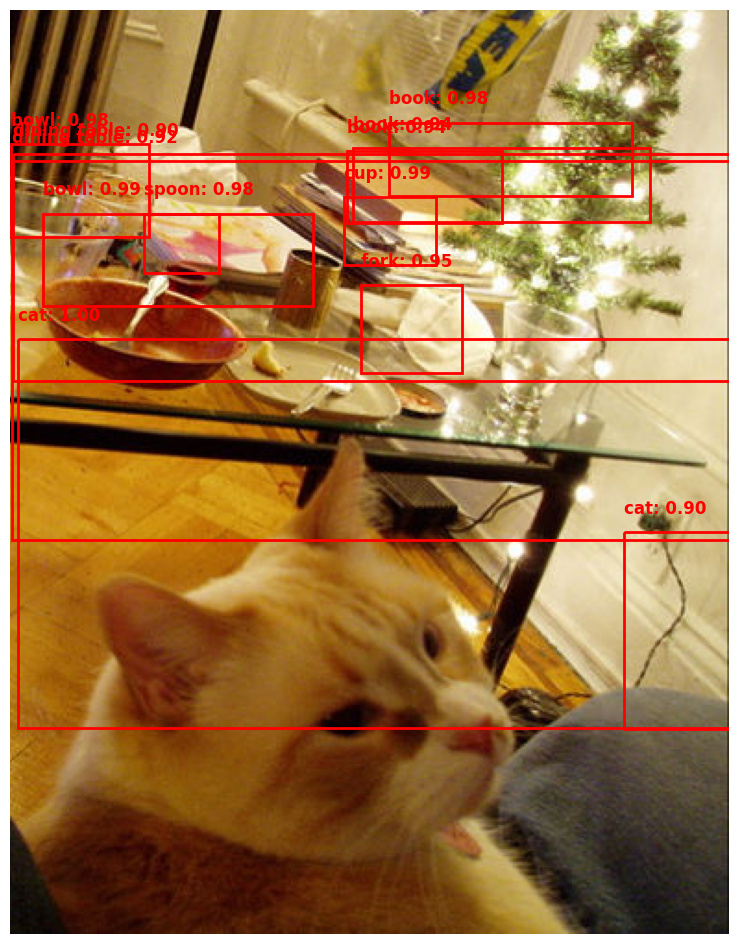

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Create a plot
fig, ax = plt.subplots(1, figsize=(12, 12))
ax.imshow(image)

# Draw bounding boxes
for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
    label_name = model.config.id2label[label.item()]
    box = box.detach().numpy()

    # Create a rectangle patch
    rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=2, edgecolor='red', facecolor='none')
    ax.add_patch(rect)
    ax.text(box[0], box[1] - 10, f"{label_name}: {score.item():.2f}", color='red', fontsize=12, weight='bold')

plt.axis('off')
plt.show()

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


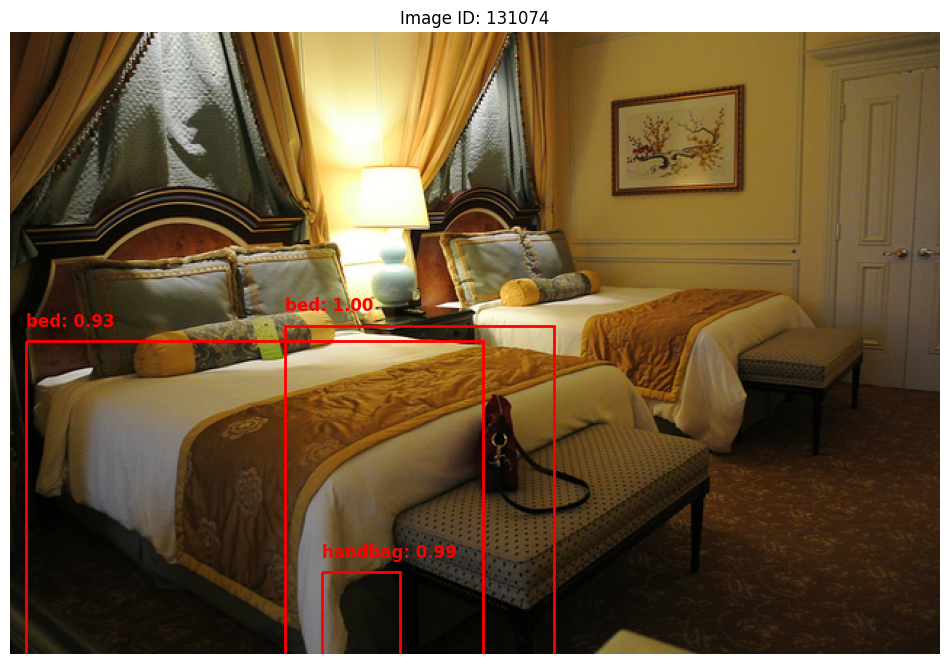

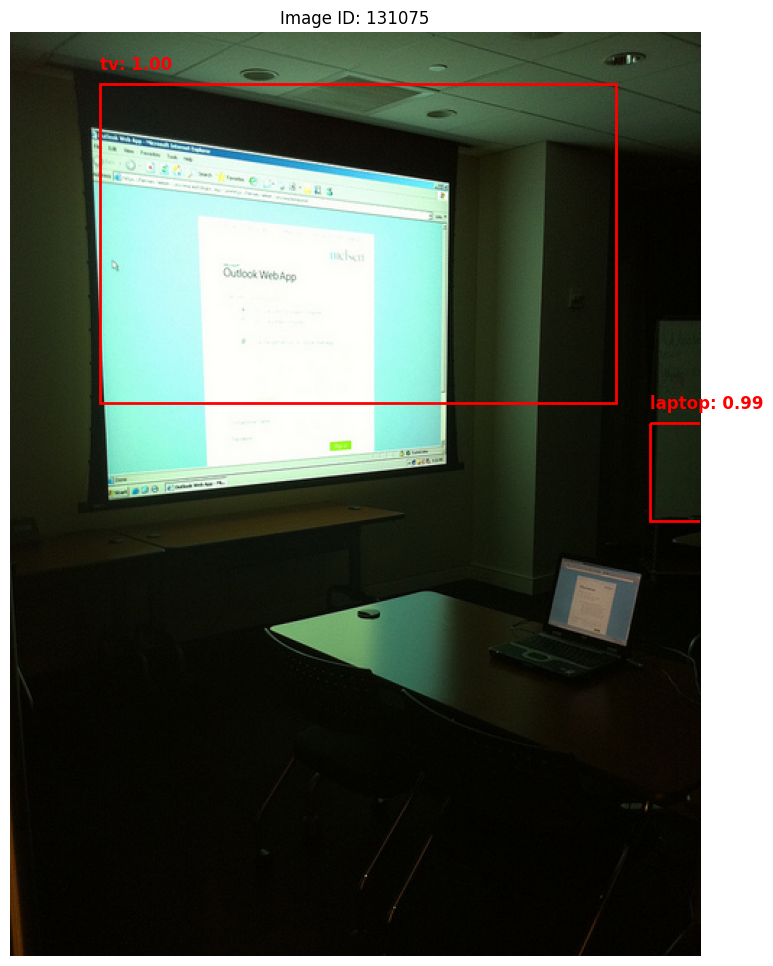

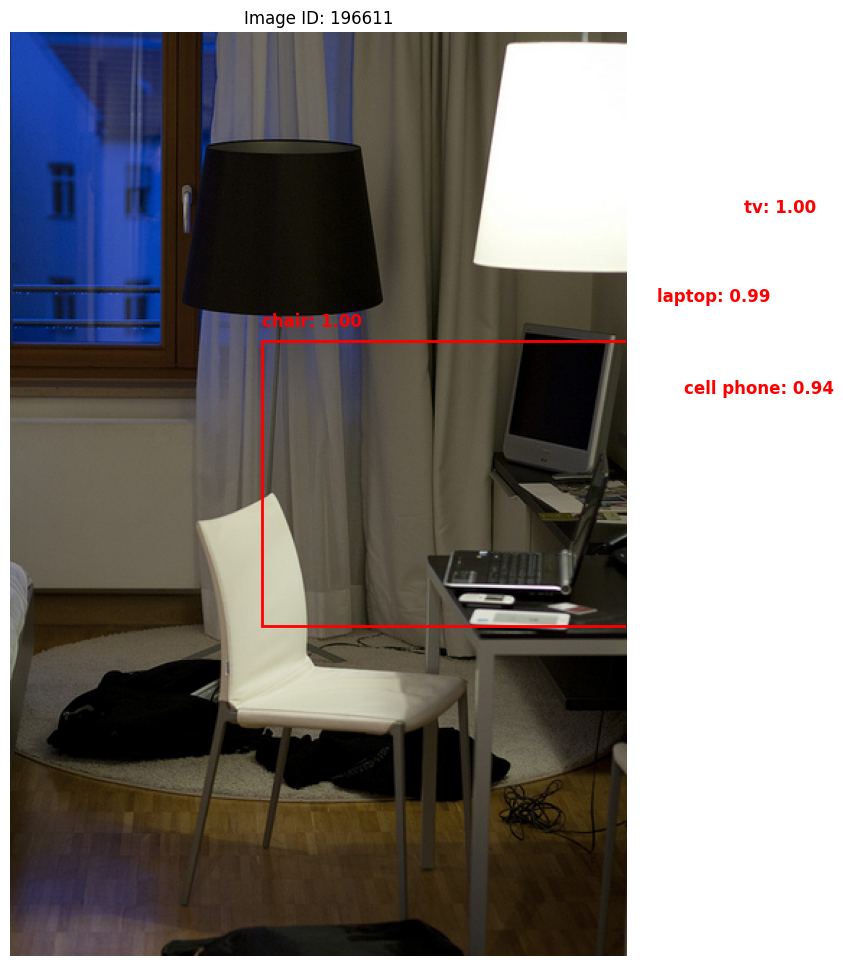

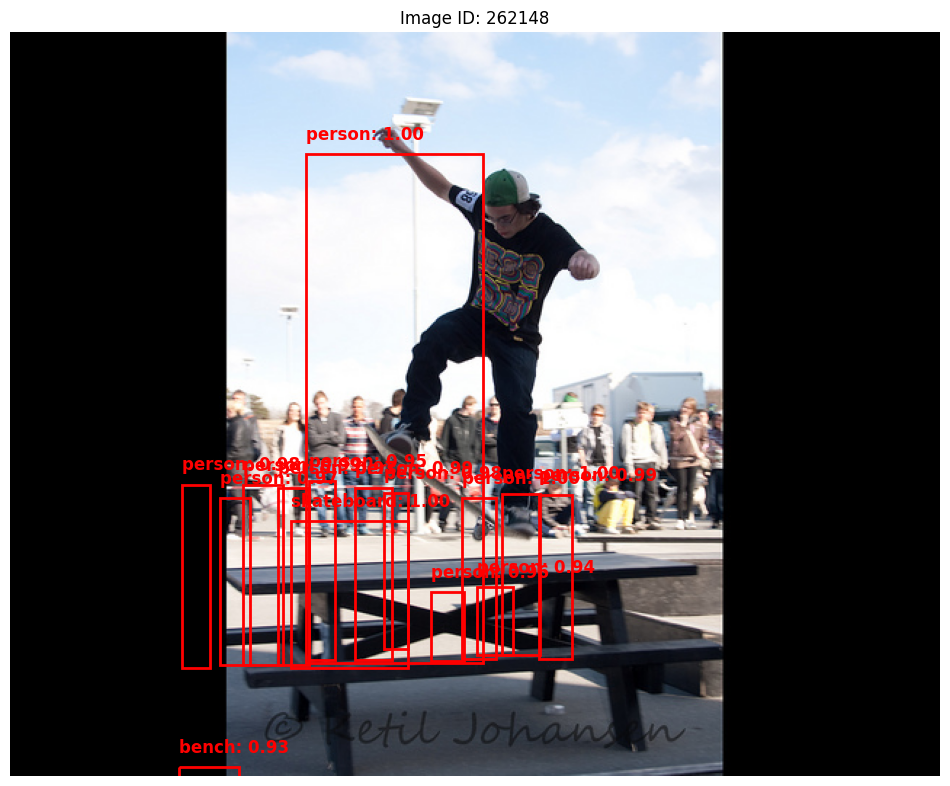

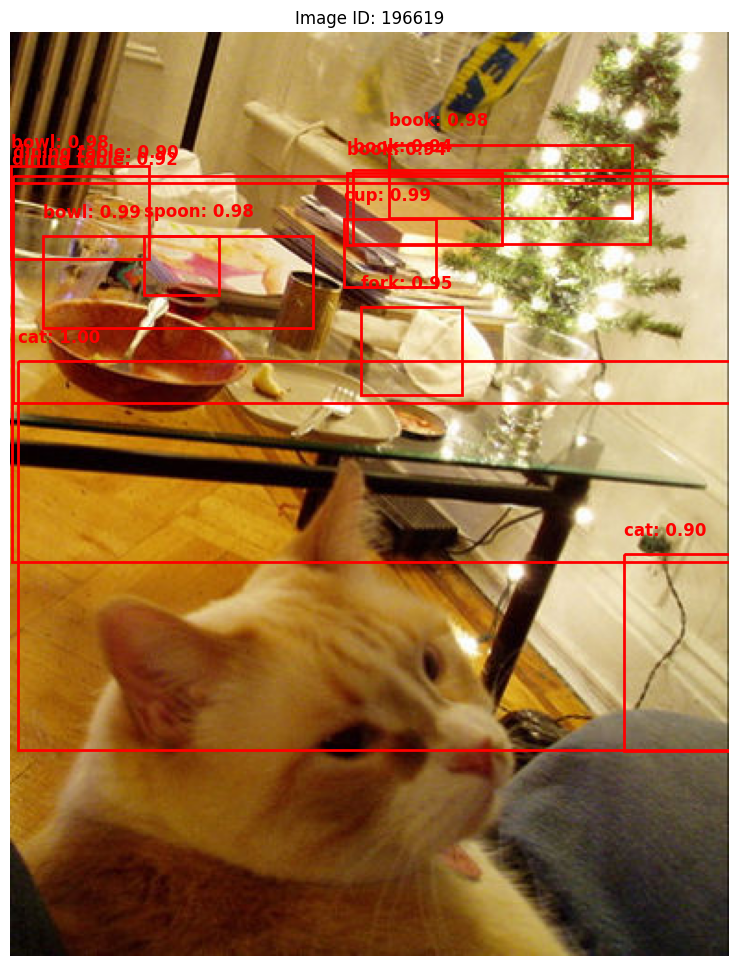

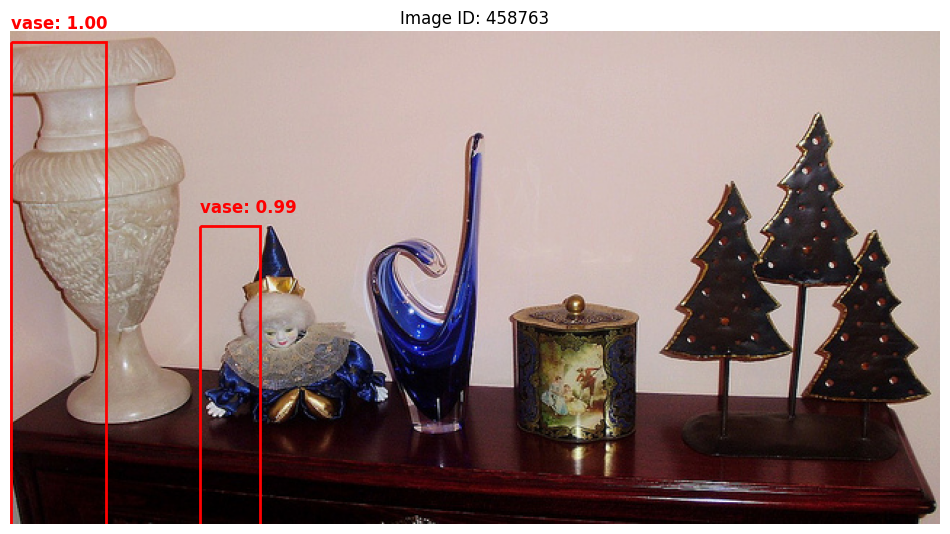

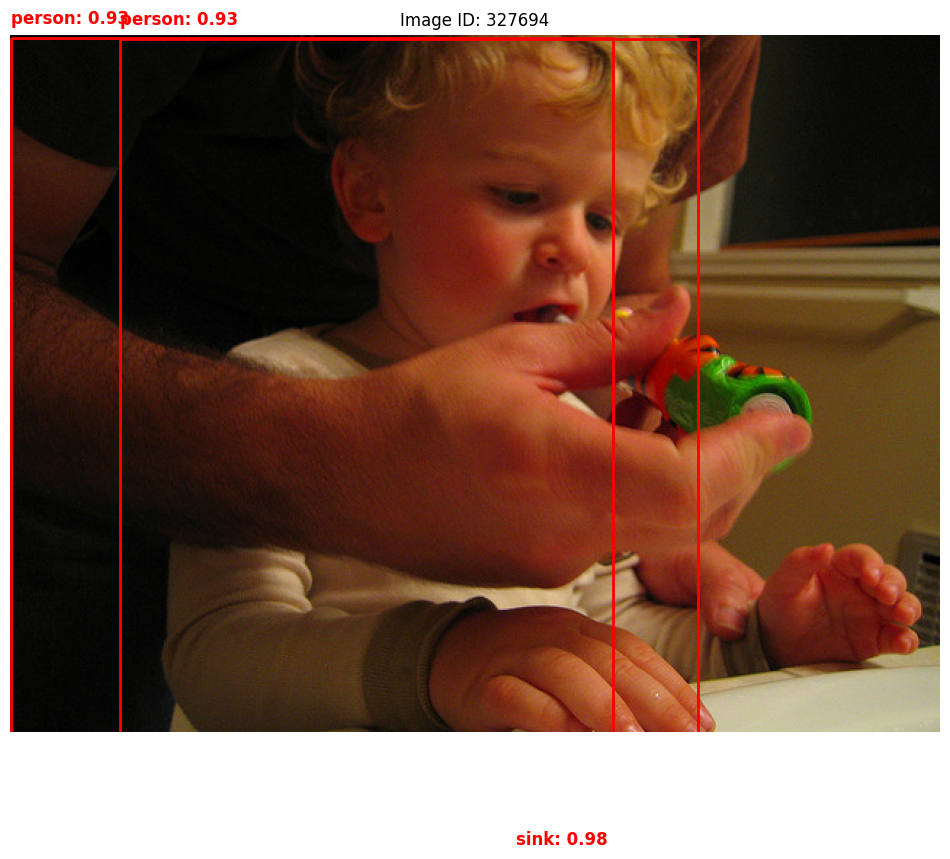

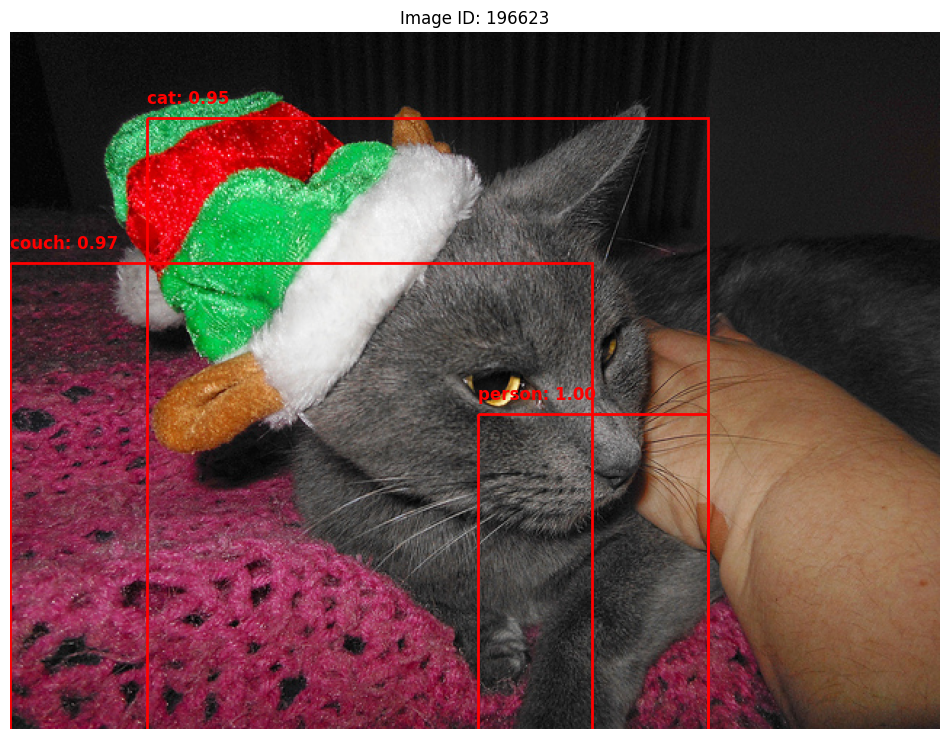

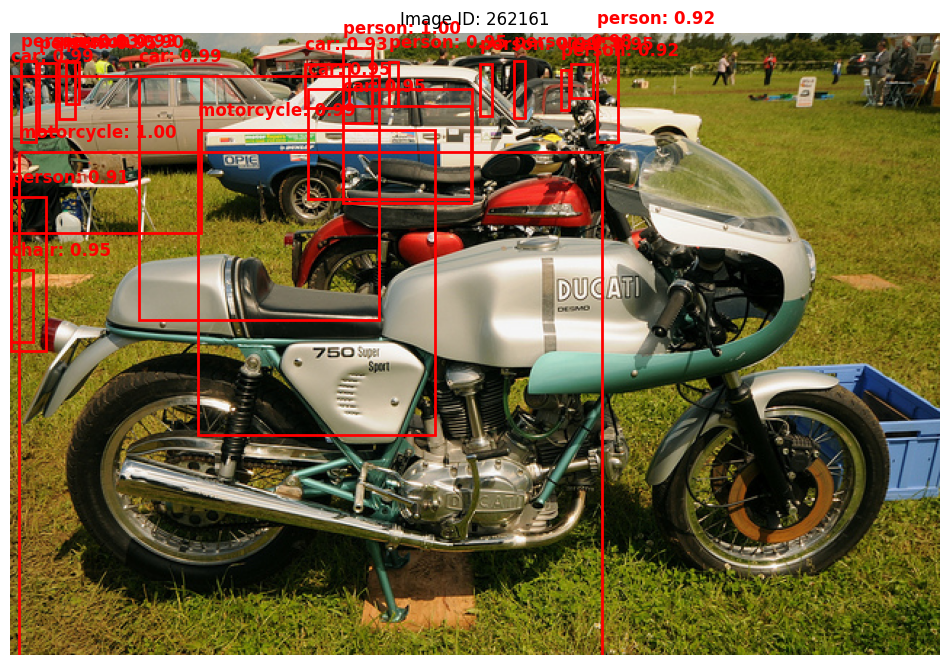

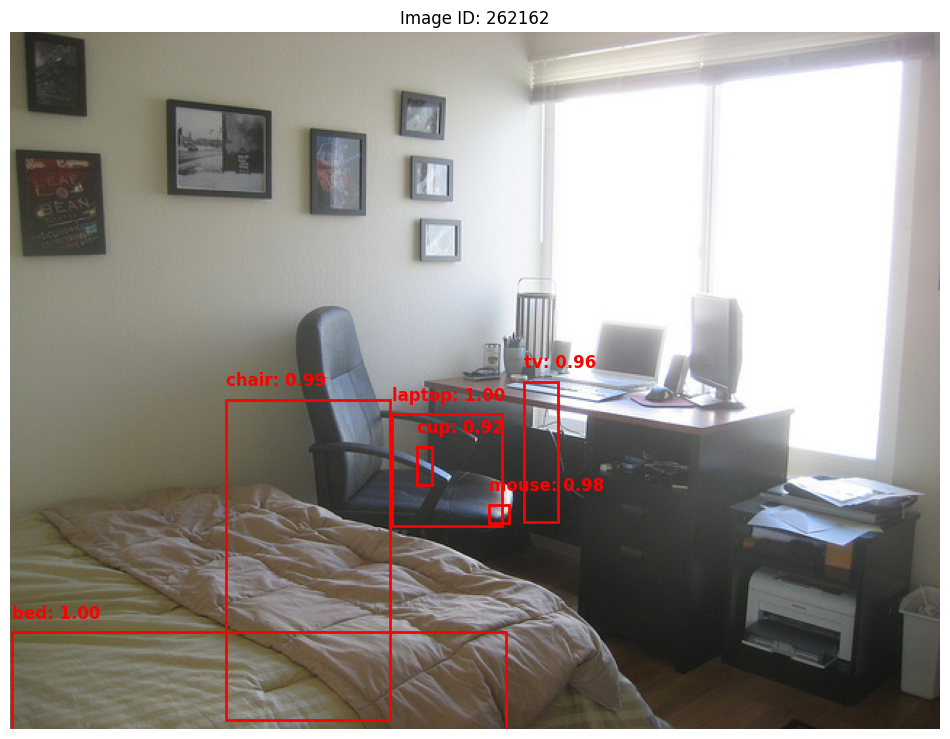

In [ ]:
import requests
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from transformers import DetrImageProcessor, DetrForObjectDetection

# Load DETR model and processor
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Iterate over all household-related images
for img_id in image_ids_list[:10]:  # Limit to 10 images for demonstration
    # Load image metadata
    img_metadata = coco.loadImgs(img_id)[0]
    image_url = img_metadata['coco_url']

    # Fetch and load the image
    response = requests.get(image_url, stream=True)
    image = Image.open(response.raw).convert("RGB")

    # Preprocess the image
    inputs = processor(images=image, return_tensors="pt")

    # Perform object detection
    outputs = model(**inputs)

    # Post-process results
    results = processor.post_process_object_detection(outputs, threshold=0.9, target_sizes=[image.size])

    # Visualize the image and bounding boxes
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image)

    for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
        label_name = model.config.id2label[label.item()]
        box = box.detach().numpy()

        # Draw bounding box
        rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                  linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Add label and confidence score
        ax.text(box[0], box[1] - 10, f"{label_name}: {score.item():.2f}",
                color='red', fontsize=12, weight='bold')

    plt.axis('off')
    plt.title(f"Image ID: {img_id}")
    plt.show()

### FINE TUNING STEPS

In [ ]:
import requests
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from transformers import DetrImageProcessor, DetrForObjectDetection

# Load DETR model and processor
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Process the first 5 images from the list
for img_id in image_ids_list[:5]:  # Limit to 5 images
    # Load image metadata
    img_metadata = coco.loadImgs(img_id)[0]
    image_url = img_metadata['coco_url']

    # Fetch and load the image
    response = requests.get(image_url, stream=True)
    image = Image.open(response.raw).convert("RGB")

    # Preprocess the image
    inputs = processor(images=image, return_tensors="pt")

    # Perform object detection
    outputs = model(**inputs)

    # Post-process results
    target_sizes = [image.size]  # Ensure correct alignment
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)

    # Visualize the image and bounding boxes
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image)

    for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
        label_name = model.config.id2label[label.item()]
        box = box.detach().numpy()

        # Draw bounding box
        rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                  linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Add label and confidence score
        ax.text(box[0], box[1] - 10, f"{label_name}: {score.item():.2f}",
                color='red', fontsize=12, weight='bold')

    plt.axis('off')
    plt.title(f"Image ID: {img_id}")
    plt.show()

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Original Image Size (Width x Height): (640, 428)
Label: bed, Score: 0.9316228628158569, Box: [ 10.425047 212.23558  324.8032   631.8133  ]
Label: handbag, Score: 0.993055522441864, Box: [214.15988 371.2659  267.97916 493.20636]
Label: bed, Score: 0.9953808784484863, Box: [188.76427 201.46771 373.58127 434.95786]


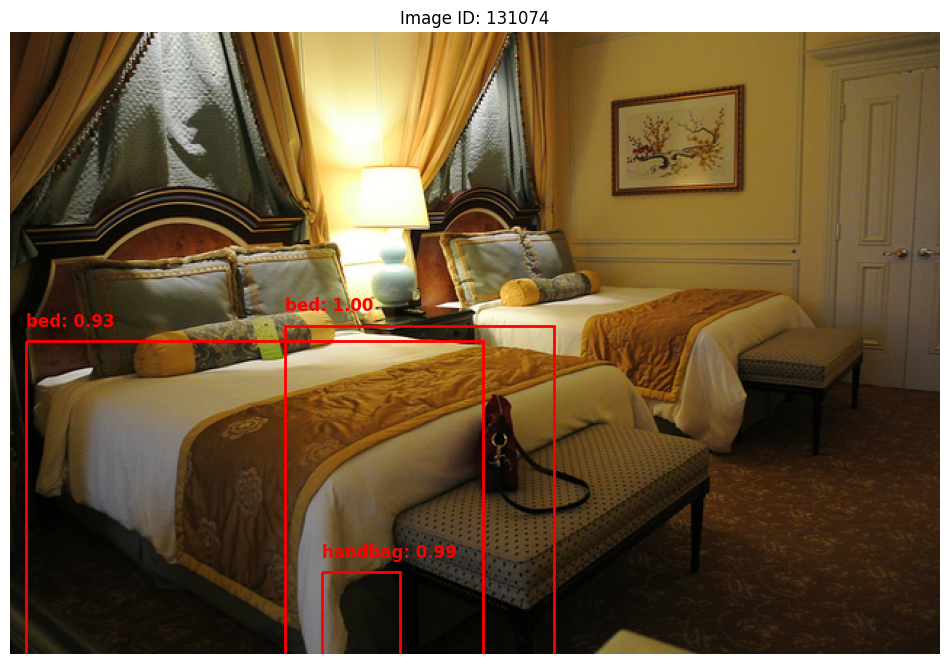

Original Image Size (Width x Height): (478, 640)
Label: tv, Score: 0.9988003969192505, Box: [ 61.916847  35.80027  419.0229   256.1272  ]
Label: laptop, Score: 0.994414210319519, Box: [442.7511  270.157   591.15546 337.91858]


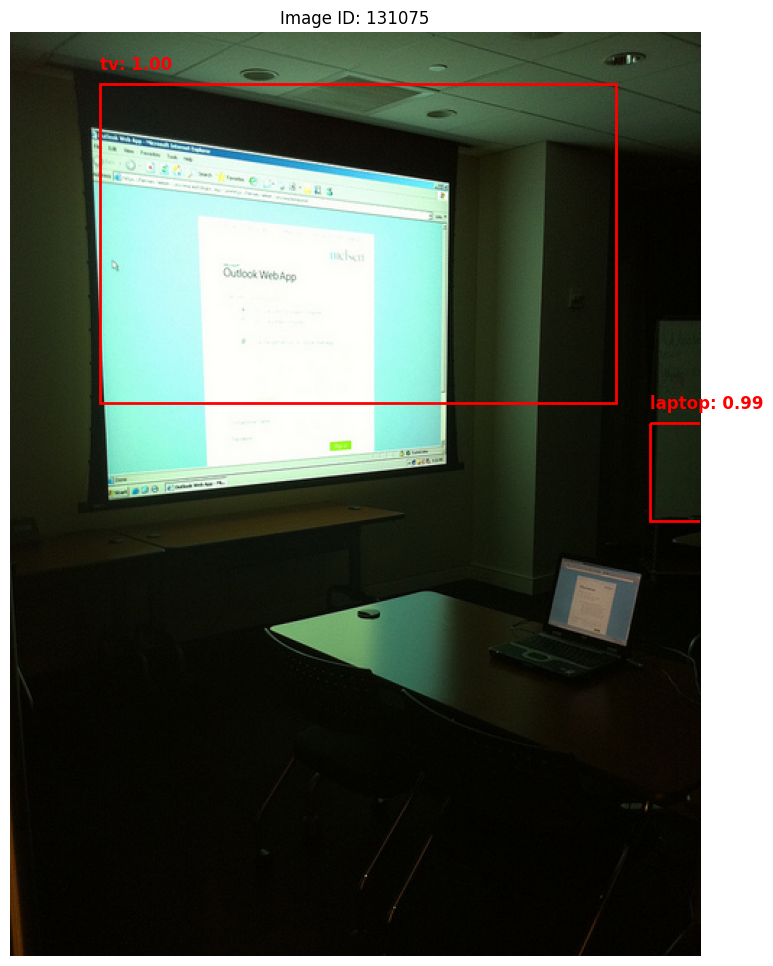

Original Image Size (Width x Height): (427, 640)
Label: tv, Score: 0.9963632225990295, Box: [508.15698 134.29399 628.92444 208.34474]
Label: chair, Score: 0.9982795715332031, Box: [174.13907 213.59784 477.9694  410.87006]
Label: laptop, Score: 0.992547333240509, Box: [447.38    196.25465 626.1929  259.786  ]
Label: cell phone, Score: 0.9403473138809204, Box: [466.22894 259.95157 521.8081  267.0781 ]


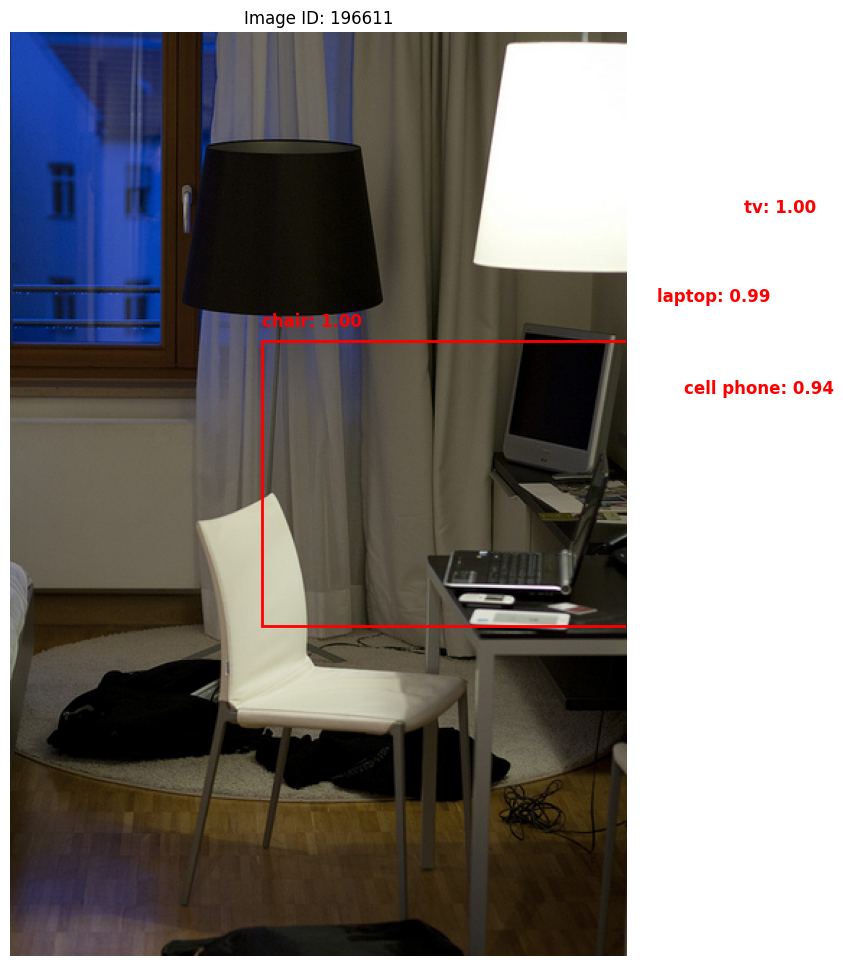

Original Image Size (Width x Height): (640, 512)
Label: person, Score: 0.9835079908370972, Box: [256.64066 316.5544  273.1987  424.05005]
Label: skateboard, Score: 0.9992936849594116, Box: [193.1815  335.87405 273.67383 437.29962]
Label: person, Score: 0.9383752942085266, Box: [320.90042 381.46124 345.97702 428.50754]
Label: bench, Score: 0.9294660687446594, Box: [116.06583 505.54855 157.16196 529.5735 ]
Label: person, Score: 0.9465757012367249, Box: [204.98697 308.58975 223.17722 431.37515]
Label: person, Score: 0.9890666007995605, Box: [363.60437 318.09686 386.20874 430.67905]
Label: person, Score: 0.9944392442703247, Box: [159.7553  311.3897  187.58324 435.1822 ]
Label: person, Score: 0.9578334093093872, Box: [289.15945 385.12915 312.12503 432.37695]
Label: person, Score: 0.9739640355110168, Box: [184.0004  313.33646 205.49295 434.89352]
Label: person, Score: 0.9920880198478699, Box: [236.74355 313.63376 262.3458  431.70642]
Label: person, Score: 0.9750378131866455, Box: [117.85636 

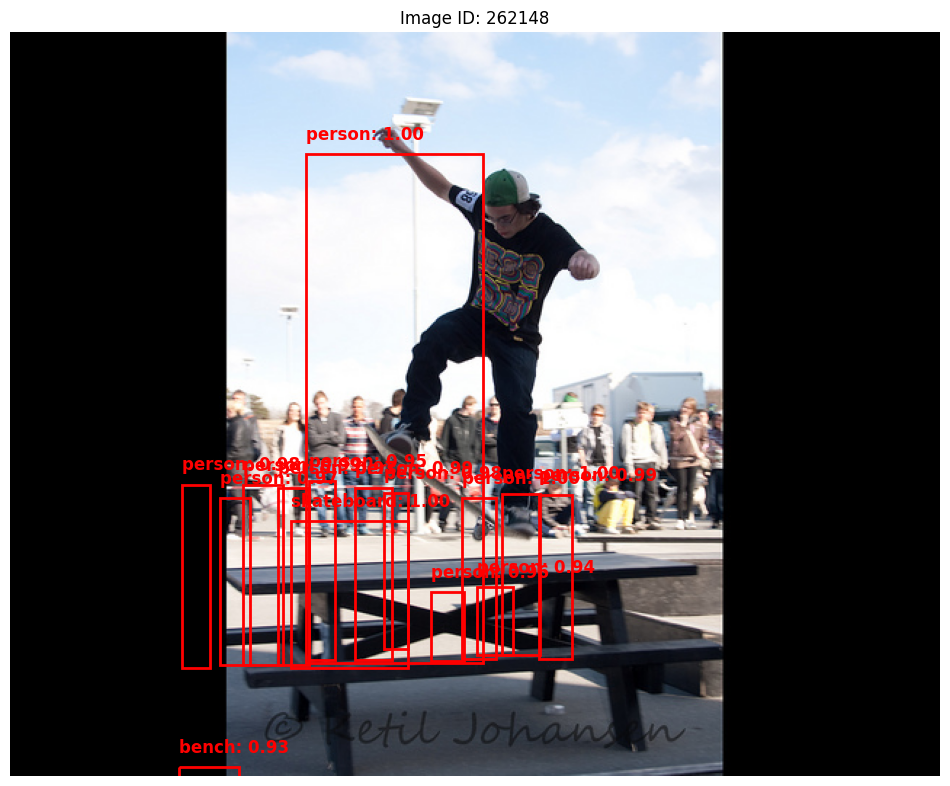

Original Image Size (Width x Height): (389, 500)
Label: dining table, Score: 0.9032135009765625, Box: [  0.9997785  77.4309    496.84842   200.43352  ]
Label: cat, Score: 0.9033619165420532, Box: [331.67697 282.15298 499.35495 388.66592]
Label: fork, Score: 0.9523788094520569, Box: [189.34807 148.4595  244.13431 195.87042]
Label: book, Score: 0.943122923374176, Box: [182.0134   76.02828 265.50864 114.64625]
Label: book, Score: 0.9796499013900757, Box: [204.81526   60.445396 336.01987   99.89062 ]
Label: bowl, Score: 0.9814097881317139, Box: [-9.0226531e-02  7.2203369e+01  7.4687325e+01  1.2227004e+02]
Label: cup, Score: 0.9904791712760925, Box: [180.01346 100.83981 229.97298 137.47989]
Label: spoon, Score: 0.9817575812339783, Box: [ 72.1838   109.63732  112.779396 142.02629 ]
Label: bowl, Score: 0.9854674339294434, Box: [ 17.432243 109.871994 163.38751  159.66995 ]
Label: book, Score: 0.9398148655891418, Box: [185.21611  74.21345 345.58862 114.22045]
Label: cat, Score: 0.99880838394165

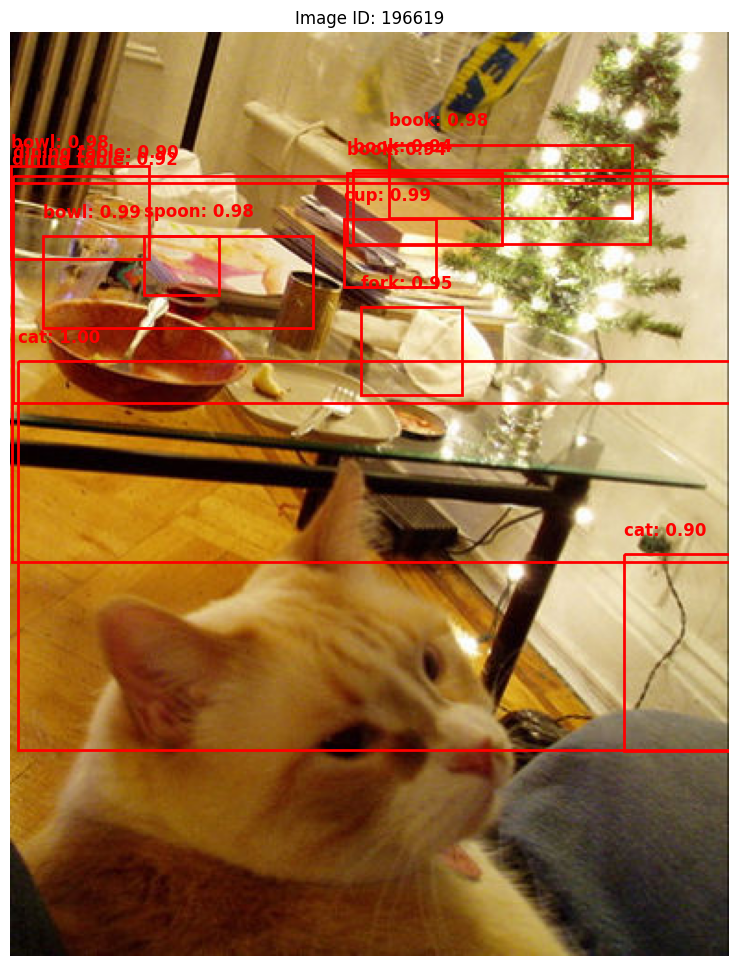

In [ ]:
import requests
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from transformers import DetrImageProcessor, DetrForObjectDetection

# Load DETR model and processor
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Process the first 5 images from the list
for img_id in image_ids_list[:5]:  # Limit to 5 images
    # Load image metadata
    img_metadata = coco.loadImgs(img_id)[0]
    image_url = img_metadata['coco_url']

    # Fetch and load the image
    response = requests.get(image_url, stream=True)
    image = Image.open(response.raw).convert("RGB")
    original_size = image.size  # (width, height)

    print(f"Original Image Size (Width x Height): {original_size}")

    # Preprocess the image
    inputs = processor(images=image, return_tensors="pt")

    # Perform object detection
    outputs = model(**inputs)

    # Post-process results
    target_sizes = [original_size]  # Use original image size
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.9)

    # Debugging: Print bounding box details
    for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
        print(f"Label: {model.config.id2label[label.item()]}, "
              f"Score: {score.item()}, "
              f"Box: {box.detach().numpy()}")

    # Visualize the image and bounding boxes
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image)

    for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
        label_name = model.config.id2label[label.item()]
        box = box.detach().numpy()

        # Draw bounding box
        rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                  linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Add label and confidence score
        ax.text(box[0], box[1] - 10, f"{label_name}: {score.item():.2f}",
                color='red', fontsize=12, weight='bold')

    plt.axis('off')
    plt.title(f"Image ID: {img_id}")
    plt.show()

### Autoscaling

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Processing Image ID 131074, Size: (640, 428)


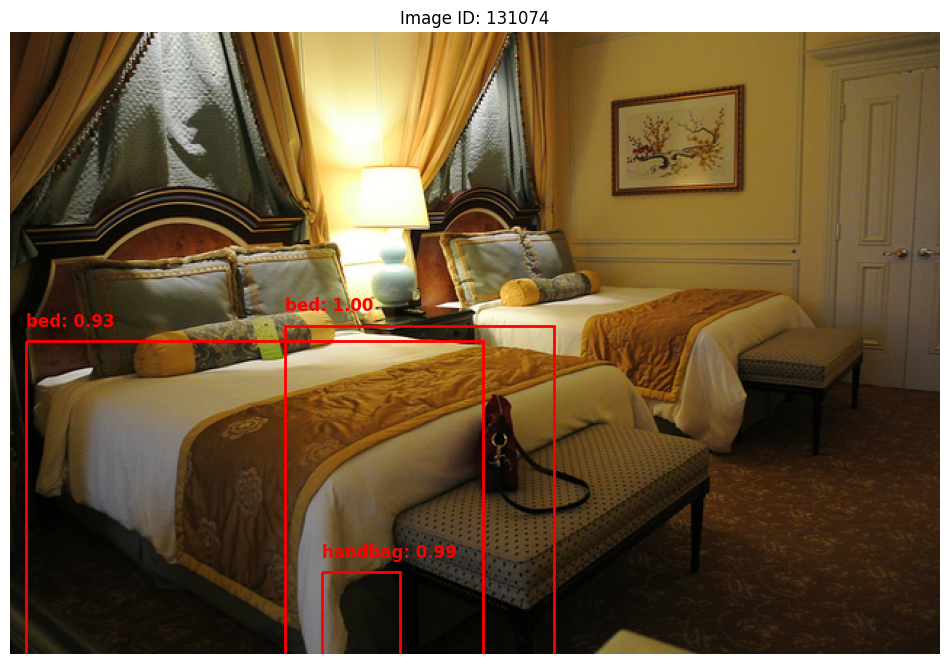

Processing Image ID 131075, Size: (478, 640)


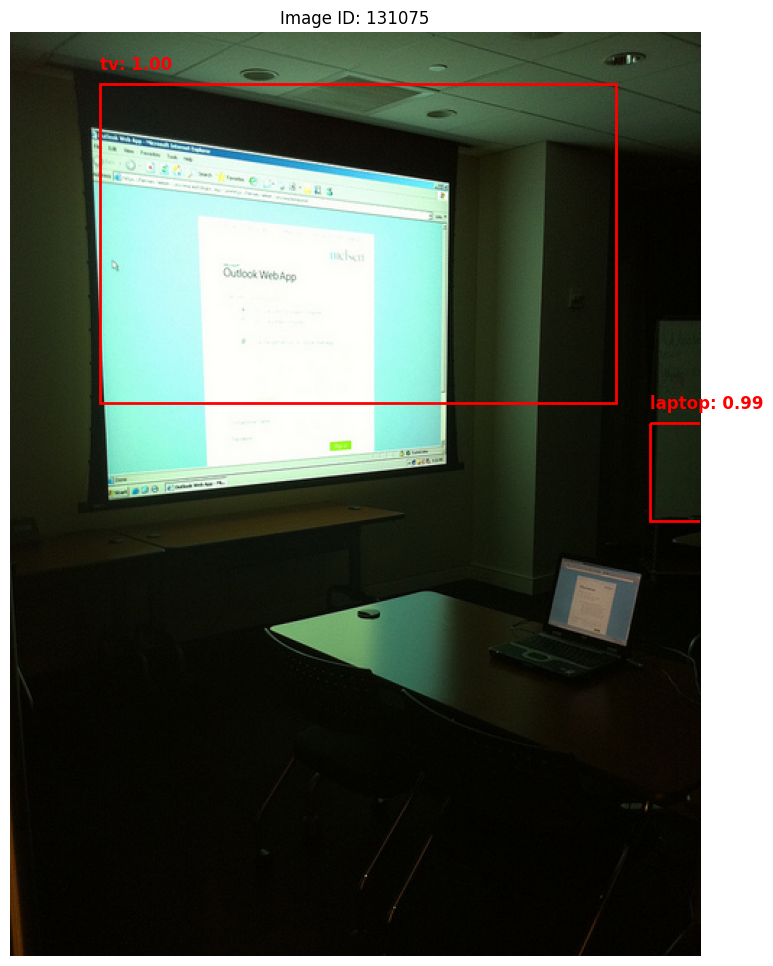

Processing Image ID 196611, Size: (427, 640)


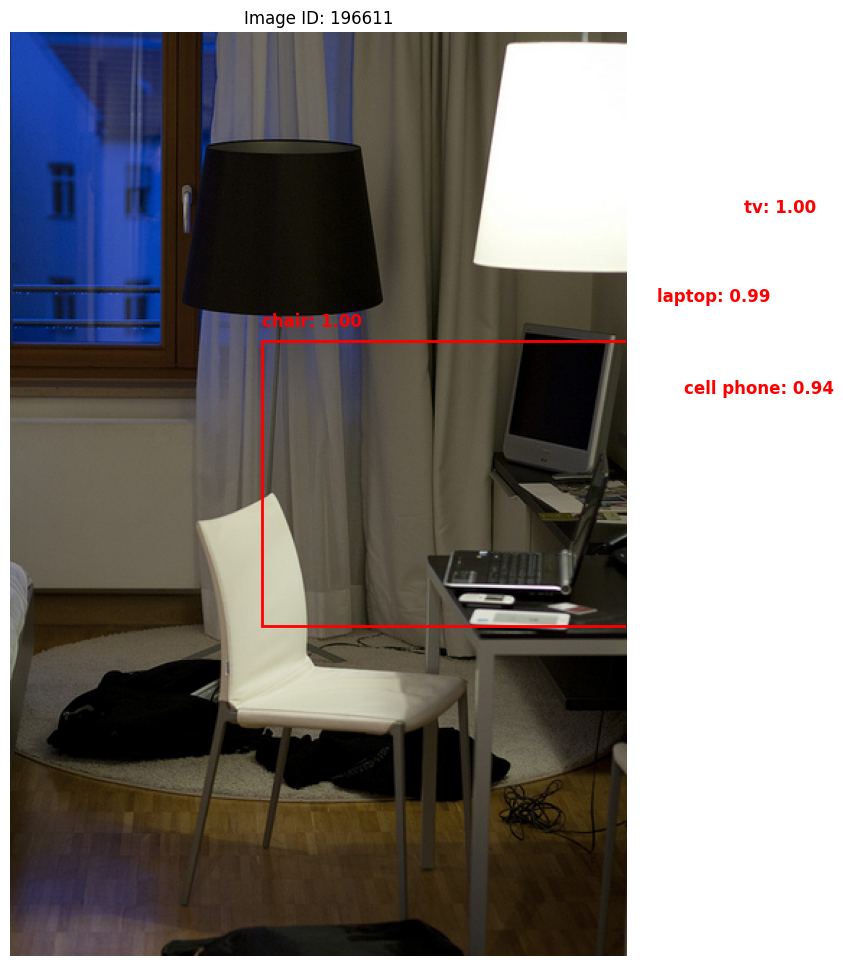

Processing Image ID 262148, Size: (640, 512)


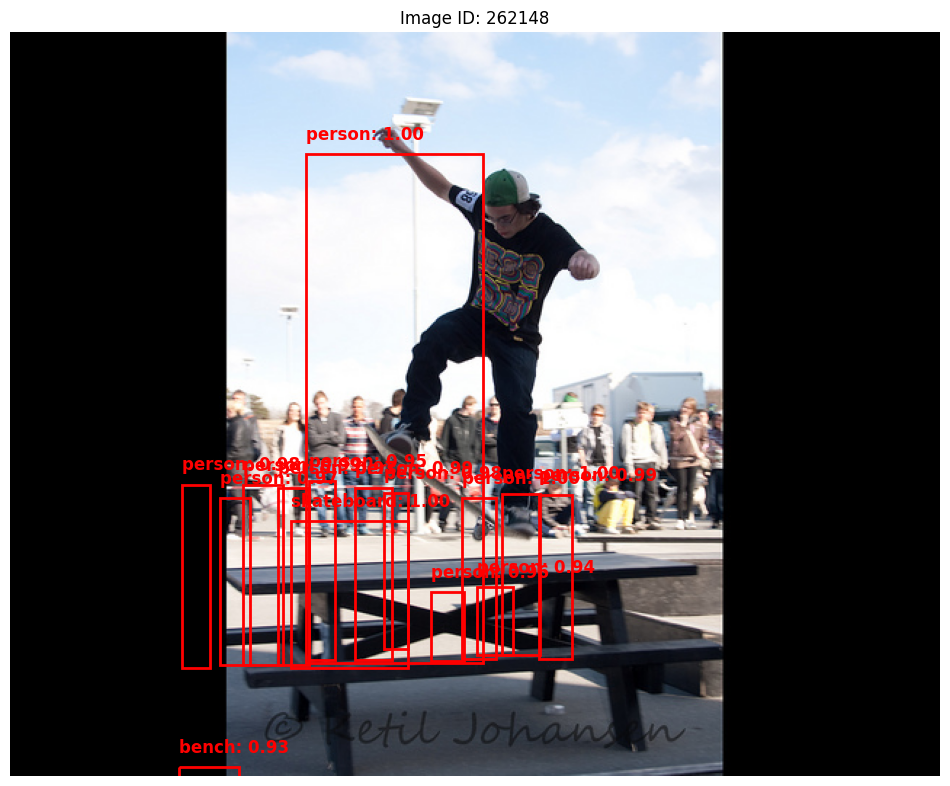

Processing Image ID 196619, Size: (389, 500)


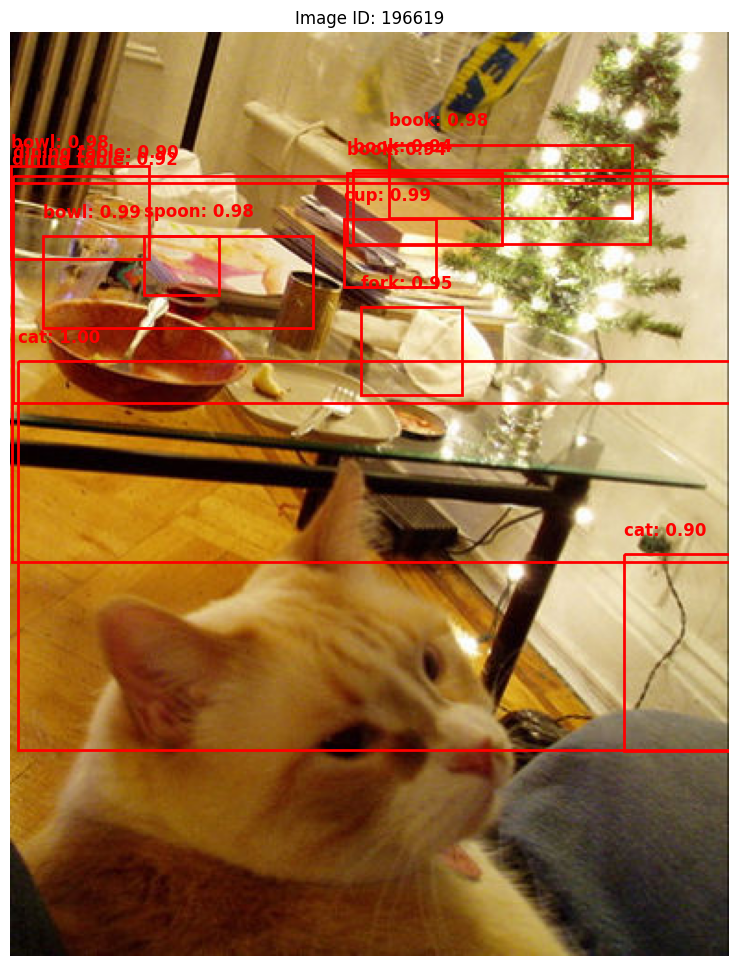

In [ ]:
import requests
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from transformers import DetrImageProcessor, DetrForObjectDetection

# Load DETR model and processor
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Process the first 5 images from the list
for img_id in image_ids_list[:5]:  # Limit to 5 images
    # Load image metadata
    img_metadata = coco.loadImgs(img_id)[0]
    image_url = img_metadata['coco_url']

    # Fetch and load the image
    response = requests.get(image_url, stream=True)
    image = Image.open(response.raw).convert("RGB")
    original_size = image.size  # (width, height)

    print(f"Processing Image ID {img_id}, Size: {original_size}")

    # Preprocess the image
    inputs = processor(images=image, return_tensors="pt")

    # Perform object detection
    outputs = model(**inputs)

    # Post-process results using the correct target size
    results = processor.post_process_object_detection(outputs, target_sizes=[original_size], threshold=0.9)

    # Visualize the image and bounding boxes
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image)

    for score, label, box in zip(results[0]["scores"], results[0]["labels"], results[0]["boxes"]):
        label_name = model.config.id2label[label.item()]
        box = box.detach().numpy()

        # Draw bounding box
        rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                  linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Add label and confidence score
        ax.text(box[0], box[1] - 10, f"{label_name}: {score.item():.2f}",
                color='red', fontsize=12, weight='bold')

    plt.axis('off')
    plt.title(f"Image ID: {img_id}")
    plt.show()